WAV file loaded from local path: C:\Users\egor_\Desktop\tests\audiospylt\source_audio\bongo.wav
Number of audio channels: 1
Sampling rate: 44100 Hz
WAV file loaded from source_audio/bongo.wav
Total duration: 1.689 seconds


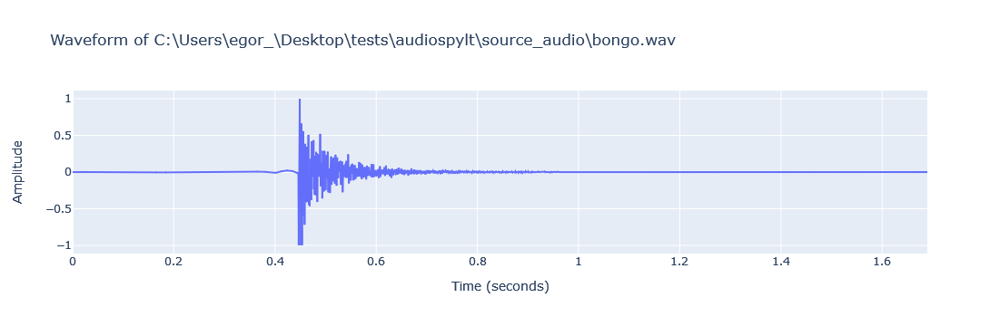

In [1]:
from IPython.display import Audio, display
from audio_utils import load_wav_from_source, load_audio_data, display_audio_properties, plot_waveform

# Adjustable variables
wav_source = 'source_audio/bongo.wav'
desired_sample_rate = None
convert_to_mono = True

# Load WAV and audio data
wav_filename = load_wav_from_source(wav_source)
audio_data, sample_rate = load_audio_data(wav_filename, desired_sample_rate, convert_to_mono)

# Display audio properties
num_channels = display_audio_properties(audio_data, sample_rate, wav_source)
# Plot waveform and get duration
duration = plot_waveform(audio_data, sample_rate, wav_filename)

# If the audio data is multi-channel, select the first channel to display
if num_channels > 1:
    audio_data = audio_data[:, 0]

# Create an audio player for the loaded file
display(Audio(audio_data, rate=sample_rate))

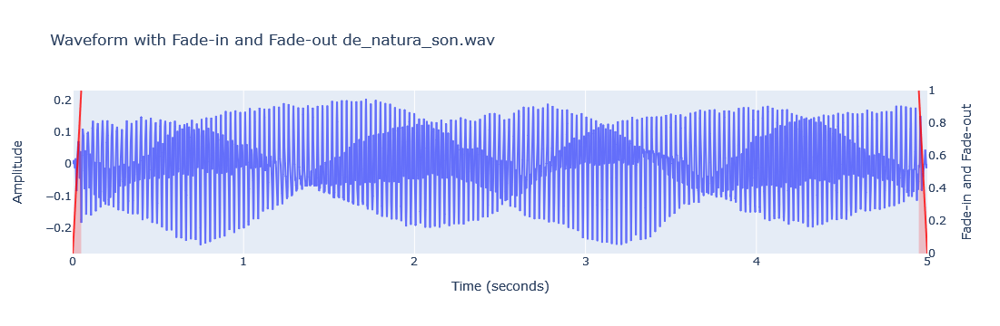

In [2]:
from audio_utils import trim_and_fade_audio

start_time = 1
end_time = 6
add_fades = True
fade_in_duration = 0.05
fade_out_duration = 0.05
fade_in_exponent = 1
fade_out_exponent = 1

cut_audio_data, cut_duration = trim_and_fade_audio(audio_data, sample_rate, num_channels, duration, wav_filename, start_time, 
                                                   end_time, add_fades, fade_in_duration, fade_out_duration, 
                                                   fade_in_exponent, fade_out_exponent)

# Create an audio player for the loaded file
display(Audio(cut_audio_data, rate=sample_rate))

File name: de_natura_son.wav
Duration (s): 5.0
Sampling rate (Hz): 44100

Maximum amplitude value: 0.040485
Total number of bands: 110251
Frequency resolution (Hz): 0.2

Amplitude Threshold 1: 0.0001
Amplitude Threshold 2: 0.05
Frequency Threshold 1 (Hz): 20
Frequency Threshold 2 (Hz): 4500

Peaks:


,Frequency (Hz),Amplitude
0,21.4,0.000131
1,22.8,0.000137
2,23.2,0.000141
3,24.4,0.000190
4,25.2,0.000378
...,...,...
121,393.2,0.000176
122,424.0,0.000322
123,530.0,0.000194
124,565.0,0.000161


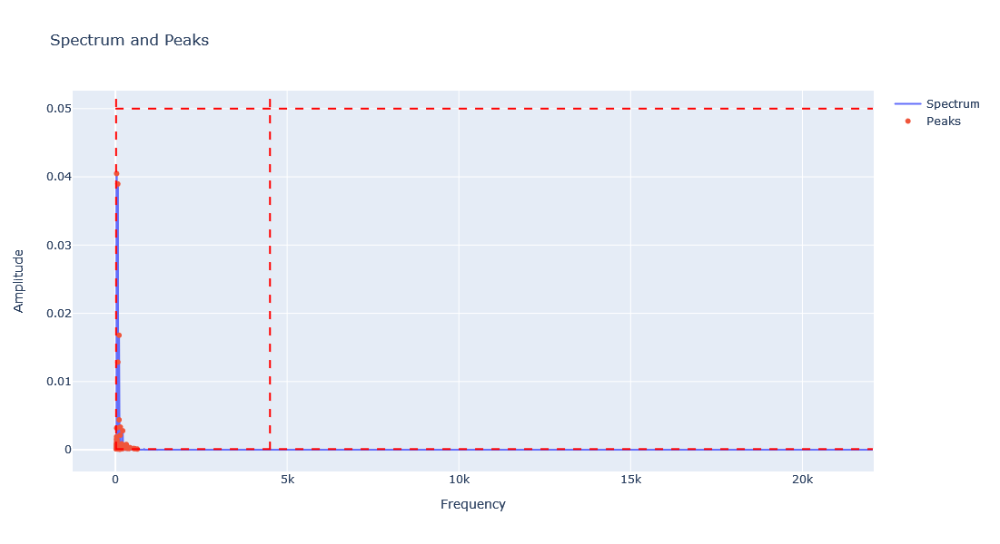

In [3]:
from dft_analysis import analyze_signal


peaks_df = analyze_signal(
        signal=cut_audio_data, 
        sr=sample_rate, 
        filename=wav_source,
        window_type='boxcar', 
        thresh_amp_low=0.0001, 
        thresh_amp_high=0.05, 
        thresh_freq_low=20, 
        thresh_freq_high=4500, 
        prominence=0.00005, 
        width=None,
        show_peaks=True, 
        show_plot=True
    )


How many spectral information is actually needed to replicate the sound character?

In [16]:
import os
from datetime import datetime

# Define the path for the /tsv subfolder
output_directory = 'tsv'

# Check if the directory exists; if not, create it
if not os.path.exists(output_directory):
    os.makedirs(output_directory)

# Define the filename path to save inside the /tsv subfolder
filename = os.path.join(output_directory, 'parm3.tsv')

try:
    peaks_df.to_csv(filename, sep='\t', index=False)
    print(f"Data saved successfully to {os.path.abspath(filename)} at {datetime.now()}.")
except:
    print("Error: data could not be saved.")


Data saved successfully to C:\Users\egor_\Desktop\tests\audiospylt\tsv\parm3.tsv at 2023-09-20 11:21:54.220725.


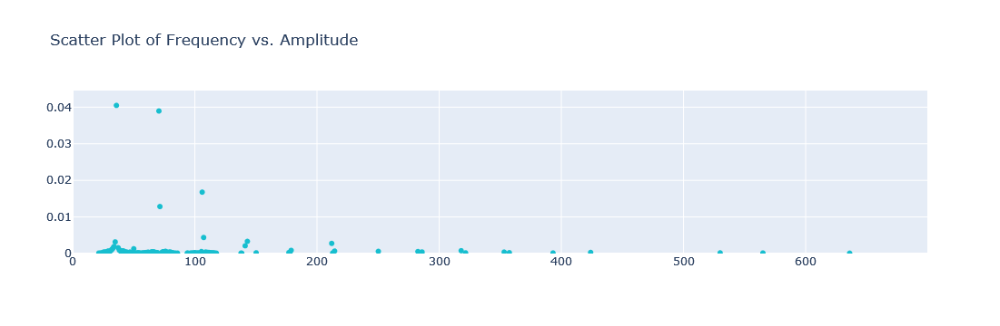

In [5]:
from multiplotter import plot_scatter

plot_scatter(dfs=[peaks_df], mode='markers')

In [6]:
from mei import process_and_visualize

process_and_visualize(peaks_df, save_mei=False, save_path='my_output.mei', display_df=True)

,Frequency (Hz),MIDI Value,MIDI Cent Deviation,Pitch Name,Note,Octave,Alter
0,21.4,17,-34,F0,F,0,1qf
1,22.8,18,-24,F#0,F,0,s
2,23.2,18,+6,F#0,F,0,1qs
3,24.4,19,-7,G0,G,0,1qf
4,25.2,19,+49,G0,G,0,1qs
...,...,...,...,...,...,...,...
121,393.2,67,+5,G4,G,4,1qs
122,424.0,68,+36,G#4,G,4,3qs
123,530.0,72,+22,C5,C,5,1qs
124,565.0,73,+33,C#5,C,5,3qs


In [7]:
import pandas as pd

# duplicate the columns into a new dataframe
double_df = pd.DataFrame({
    "freq_data1": peaks_df["Frequency (Hz)"],
    "amp_data1": peaks_df["Amplitude"],
    "freq_data2": peaks_df["Frequency (Hz)"],
    "amp_data2": peaks_df["Amplitude"]
})

pd.reset_option('all')

display(double_df)


,freq_data1,amp_data1,freq_data2,amp_data2
0,21.4,0.000131,21.4,0.000131
1,22.8,0.000137,22.8,0.000137
2,23.2,0.000141,23.2,0.000141
3,24.4,0.000190,24.4,0.000190
4,25.2,0.000378,25.2,0.000378
...,...,...,...,...
121,393.2,0.000176,393.2,0.000176
122,424.0,0.000322,424.0,0.000322
123,530.0,0.000194,530.0,0.000194
124,565.0,0.000161,565.0,0.000161


In [8]:
import pandas as pd
import numpy as np

def process_df(input_df, freq_start_col, amp_start_col, freq_stop_col, amp_stop_col, wave_stop_value, override_amp_value=None, scale_amp_value=True):
    # Scaling amplitude if required
    if scale_amp_value:
        amp_start_scaled = input_df[amp_start_col] / input_df[amp_start_col].max()
        amp_stop_max = input_df[amp_stop_col] / input_df[amp_stop_col].max()
    else:
        amp_start_scaled = input_df[amp_start_col]
        amp_stop_max = input_df[amp_stop_col]
    
    # Overriding amplitude values if required
    if override_amp_value is not None:
        amp_min = [override_amp_value] * len(input_df)
        amp_max = [override_amp_value] * len(input_df)
    else:
        amp_min = amp_start_scaled
        amp_max = amp_stop_max

    new_data = {
        "freq_start": input_df[freq_start_col],
        "freq_stop": input_df[freq_stop_col],
        "time_start": [0.0] * len(input_df),
        "time_stop": [wave_stop_value] * len(input_df),
        "amp_min": amp_min,
        "amp_max": amp_max
    }
    
    return pd.DataFrame(new_data)

wave_stop_value = 15.0
override_amp_value = None
scale_amp_value = True

new_df = process_df(double_df, 'freq_data1', 'amp_data1', 'freq_data2', 'amp_data2', wave_stop_value, override_amp_value, scale_amp_value)
display(new_df)


,freq_start,freq_stop,time_start,time_stop,amp_min,amp_max
0,21.4,21.4,0.0,15.0,0.003234,0.003234
1,22.8,22.8,0.0,15.0,0.003389,0.003389
2,23.2,23.2,0.0,15.0,0.003484,0.003484
3,24.4,24.4,0.0,15.0,0.004697,0.004697
4,25.2,25.2,0.0,15.0,0.009339,0.009339
...,...,...,...,...,...,...
121,393.2,393.2,0.0,15.0,0.004340,0.004340
122,424.0,424.0,0.0,15.0,0.007942,0.007942
123,530.0,530.0,0.0,15.0,0.004783,0.004783
124,565.0,565.0,0.0,15.0,0.003983,0.003983


In [9]:
def estimate_sampling_frequency_and_time_vector_updated(new_df):
    # Estimating the sampling frequency based on the highest frequency in the df
    highest_frequency = max(new_df['freq_start'].max(), new_df['freq_stop'].max())
    sampling_frequency = 2 * highest_frequency
    
    # Use the highest value from the time_stop column as wave_stop_value
    wave_stop_value = new_df['time_stop'].max()
    
    # Calculate the sampling interval
    delta_t = 1 / sampling_frequency
    
    return sampling_frequency, delta_t, wave_stop_value

# Using the updated function to estimate the sampling frequency and time vector
sampling_frequency_updated, delta_t_updated, duration = estimate_sampling_frequency_and_time_vector_updated(new_df)

# Printing the results
print(f"Estimated Optimal Sampling Frequency: {sampling_frequency_updated:.3f} Hz")
print(f"Sampling Interval (Delta t): {delta_t_updated:.6f} seconds")
print(f"Duration (highest value from time_stop column): {duration:.3f} seconds")


Estimated Optimal Sampling Frequency: 1272.000 Hz
Sampling Interval (Delta t): 0.000786 seconds
Duration (highest value from time_stop column): 15.000 seconds


In [12]:
from plot_wave import plot_waves

# define the time vector (from 0 to n seconds, with a step of k seconds)
k=0.00075

y_combined = plot_waves(new_df, k, disable_freq_plot=True, disable_amp_plot=True, disable_combined_plot=True, disable_wave_plot=True)

In [13]:
import numpy as np
from generate_wave_file import generate_wave_file
from IPython.display import Audio, display

player = True
save_audio = False

y_combined_no_nan = np.nan_to_num(y_combined)

fs_initial = 1 / k  # The initial sampling rate is the inverse of the time step (k)

def display_audio_from_array(audio_data, sample_rate):
    """Display the audio player using audio data array."""
    display(Audio(audio_data, rate=sample_rate))

# Generate the wave or audio data
if save_audio:
    filename = generate_wave_file(y_combined_no_nan, fs_initial, fs_target_name='44.1kHz', bit_rate=24, save_to_file=True)
    if player:
        display(Audio(filename=filename))
else:
    audio_data, fs_target = generate_wave_file(y_combined_no_nan, fs_initial, fs_target_name='44.1kHz', bit_rate=24, save_to_file=False)
    if player:
        display_audio_from_array(audio_data, fs_target)